In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns

import pandas as pd
import numpy as np
from pylab import rcParams

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, precision_recall_curve
from sklearn.metrics import recall_score, classification_report, auc, roc_curve
from sklearn.metrics import precision_recall_fscore_support, f1_score

from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

from numpy.random import seed
seed(7)

from sklearn.model_selection import train_test_split

SEED = 123
DATA_SPLIT_PCT = 0.2

rcParams['figure.figsize'] = 8, 6
LABELS = ["Normal","Break"]

In [2]:
df = pd.read_csv("combined_filtered.csv") 
df.head(n=5)

,Unnamed: 0,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
0,0,2023-09-19T14:21:53.393Z,1,0,0,1857,11866,1693,2390,2640,11855,0,1
1,1,2023-09-19T14:21:53.485Z,1,0,0,1862,11896,1679,2396,2643,11908,0,1
2,2,2023-09-19T14:21:53.582Z,1,0,0,1867,11957,1669,2379,2659,11939,0,1
3,3,2023-09-19T14:21:53.687Z,1,0,0,1886,11955,1699,2403,2612,11932,0,1
4,4,2023-09-19T14:21:53.793Z,1,0,0,1887,11966,1670,2388,2630,11931,0,1


In [3]:
pd.set_option('display.max_columns', None)
df.head()

,Unnamed: 0,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
0,0,2023-09-19T14:21:53.393Z,1,0,0,1857,11866,1693,2390,2640,11855,0,1
1,1,2023-09-19T14:21:53.485Z,1,0,0,1862,11896,1679,2396,2643,11908,0,1
2,2,2023-09-19T14:21:53.582Z,1,0,0,1867,11957,1669,2379,2659,11939,0,1
3,3,2023-09-19T14:21:53.687Z,1,0,0,1886,11955,1699,2403,2612,11932,0,1
4,4,2023-09-19T14:21:53.793Z,1,0,0,1887,11966,1670,2388,2630,11931,0,1


In [4]:
df = df.drop(['Unnamed: 0'], axis=1)

In [5]:
df['Success'].value_counts()

1    212296
0      3738
Name: Success, dtype: int64

In [6]:
df['Success'] = df['Success'].replace({1: 0, 0: 1})
df

,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
0,2023-09-19T14:21:53.393Z,1,0,0,1857,11866,1693,2390,2640,11855,0,0
1,2023-09-19T14:21:53.485Z,1,0,0,1862,11896,1679,2396,2643,11908,0,0
2,2023-09-19T14:21:53.582Z,1,0,0,1867,11957,1669,2379,2659,11939,0,0
3,2023-09-19T14:21:53.687Z,1,0,0,1886,11955,1699,2403,2612,11932,0,0
4,2023-09-19T14:21:53.793Z,1,0,0,1887,11966,1670,2388,2630,11931,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
216029,2023-09-19T20:21:59.584Z,0,0,0,1888,2061,1676,2382,2604,11801,1,1
216030,2023-09-19T20:21:59.686Z,0,0,0,1854,2061,1686,2404,2776,11878,1,1
216031,2023-09-19T20:21:59.785Z,0,0,0,1859,2073,1685,2403,3218,11917,1,1
216032,2023-09-19T20:21:59.887Z,0,0,0,1860,2067,1655,2385,2176,11904,1,1


In [7]:
df['Success'].value_counts()

0    212296
1      3738
Name: Success, dtype: int64

In [144]:
df.to_csv('combined_filtered_new.csv')

In [8]:
df.iloc[:60000,:]

,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
0,2023-09-19T14:21:53.393Z,1,0,0,1857,11866,1693,2390,2640,11855,0,0
1,2023-09-19T14:21:53.485Z,1,0,0,1862,11896,1679,2396,2643,11908,0,0
2,2023-09-19T14:21:53.582Z,1,0,0,1867,11957,1669,2379,2659,11939,0,0
3,2023-09-19T14:21:53.687Z,1,0,0,1886,11955,1699,2403,2612,11932,0,0
4,2023-09-19T14:21:53.793Z,1,0,0,1887,11966,1670,2388,2630,11931,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
59995,2023-09-19T16:01:53.855Z,1,1,0,1889,11962,1689,2392,2627,11902,1,1
59996,2023-09-19T16:01:53.857Z,1,1,0,1875,11919,1700,2402,2608,11813,1,1
59997,2023-09-19T16:01:53.886Z,1,1,0,1899,11970,1696,2399,2596,11841,1,1
59998,2023-09-19T16:01:53.984Z,1,1,0,1860,11888,1698,2388,2720,11987,1,1


In [9]:
df.iloc[60000:120000]

,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
60000,2023-09-19T16:01:54.174Z,1,1,0,1849,11900,1694,2393,2597,11803,1,1
60001,2023-09-19T16:01:54.296Z,1,1,0,1860,11886,1693,2388,2653,11937,1,1
60002,2023-09-19T16:01:54.389Z,1,1,0,1867,11956,1677,2390,2612,11885,1,1
60003,2023-09-19T16:01:54.481Z,1,1,0,1874,11997,1688,2376,2665,11886,1,1
60004,2023-09-19T16:01:54.582Z,1,1,0,1893,11975,1683,2380,2615,11897,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
119995,2023-09-19T17:41:54.863Z,0,0,0,1885,11976,1705,2377,2803,5409,0,0
119996,2023-09-19T17:41:54.864Z,0,0,0,1837,11892,1705,2377,2649,5299,0,0
119997,2023-09-19T17:41:54.876Z,0,0,0,1852,11971,1678,2386,2685,5310,0,0
119998,2023-09-19T17:41:54.983Z,0,0,0,1856,11939,1694,2389,2589,5238,0,0


In [10]:
input_X = df.loc[:, df.columns != 'Success'].values  # converts the df to a numpy array
input_y = df['Success'].values

n_features = input_X.shape[1]  # number of features

In [11]:
sign = lambda x: (1, -1)[x < 0]

def curve_shift(df, shift_by):
    vector = df['Success'].copy()
    for s in range(abs(shift_by)):
        tmp = vector.shift(sign(shift_by))
        tmp = tmp.fillna(0)
        vector += tmp
    labelcol = 'Success'
    # Add vector to the df
    df.insert(loc=0, column=labelcol+'tmp', value=vector)
    # Remove the rows with labelcol == 1.
    df = df.drop(df[df[labelcol] == 1].index)
    # Drop labelcol and rename the tmp col as labelcol
    df = df.drop(labelcol, axis=1)
    df = df.rename(columns={labelcol+'tmp': labelcol})
    # Make the labelcol binary
    df.loc[df[labelcol] > 0, labelcol] = 1

    return df


In [12]:
'''
Shift the data by 70 units

Test: Testing whether the shift happened correctly.
'''
print('Before shifting')  # Positive labeled rows before shifting.
one_indexes = df.index[df['Success'] == 1]
display(df.iloc[(np.where(np.array(input_y) == 1)[0][0]):(np.where(np.array(input_y) == 1)[0][0]+70), ])

# Shift the response column y by 210 rows.
df = curve_shift(df, shift_by = -210)


print('After shifting')  # Validating if the shift happened correctly.
display(df.iloc[(one_indexes[0]):(one_indexes[0])+600000, 0:11].head(n=5))

Before shifting


,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally,Success
59019,2023-09-19T16:00:16.080Z,0,1,0,1877,12035,1697,2388,2522,12053,1,1
59020,2023-09-19T16:00:16.176Z,0,1,0,1914,12125,1697,2388,2651,12150,1,1
59021,2023-09-19T16:00:16.285Z,0,1,0,1898,12073,1690,2392,2460,12003,1,1
59022,2023-09-19T16:00:16.387Z,0,1,0,1887,12084,1710,2387,2493,12082,1,1
59023,2023-09-19T16:00:16.487Z,0,1,0,1889,12054,1694,2380,2526,12108,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...
59084,2023-09-19T16:00:22.591Z,0,1,0,1899,12043,1695,2387,2508,12013,1,1
59085,2023-09-19T16:00:22.913Z,0,1,0,1885,12004,1697,2386,2518,12085,1,1
59086,2023-09-19T16:00:22.915Z,0,1,0,1918,12055,1689,2393,2509,12069,1,1
59087,2023-09-19T16:00:22.916Z,0,1,0,1906,12044,1673,2384,2509,12060,1,1


After shifting


,Success,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04
60774,0.0,2023-09-19T16:03:11.580Z,1,0,0,1873,11895,1712,2407,2545,11744
60775,0.0,2023-09-19T16:03:11.812Z,1,0,0,1851,11882,1708,2404,2659,11895
60776,0.0,2023-09-19T16:03:11.813Z,1,0,0,1878,11993,1680,2393,2601,11886
60777,0.0,2023-09-19T16:03:11.895Z,1,0,0,1895,11937,1678,2392,2716,11947
60778,0.0,2023-09-19T16:03:11.978Z,1,0,0,1854,11932,1700,2398,2694,11932


In [13]:
df

,Success,_time,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Anomally
0,0.0,2023-09-19T14:21:53.393Z,1,0,0,1857,11866,1693,2390,2640,11855,0
1,0.0,2023-09-19T14:21:53.485Z,1,0,0,1862,11896,1679,2396,2643,11908,0
2,0.0,2023-09-19T14:21:53.582Z,1,0,0,1867,11957,1669,2379,2659,11939,0
3,0.0,2023-09-19T14:21:53.687Z,1,0,0,1886,11955,1699,2403,2612,11932,0
4,0.0,2023-09-19T14:21:53.793Z,1,0,0,1887,11966,1670,2388,2630,11931,0
...,...,...,...,...,...,...,...,...,...,...,...,...
215717,1.0,2023-09-19T20:21:28.375Z,0,1,0,1902,2079,1683,2394,2673,11891,1
215718,1.0,2023-09-19T20:21:28.486Z,0,1,0,1872,2077,1713,2425,2609,11928,1
215719,1.0,2023-09-19T20:21:28.594Z,0,1,0,1874,2071,1687,2398,2671,11854,1
215720,1.0,2023-09-19T20:21:28.683Z,0,1,0,1880,2077,1685,2404,2077,11899,1


In [14]:
# Remove time column, and the categorical columns
df = df.drop(['_time'], axis=1)

In [15]:
df=df.drop(['Anomally'], axis=1)

In [16]:
X = df.drop(['Success'], axis=1)

y = df['Success']

In [17]:
y

0         0.0
1         0.0
2         0.0
3         0.0
4         0.0
         ... 
215717    1.0
215718    1.0
215719    1.0
215720    1.0
215721    1.0
Name: Success, Length: 212296, dtype: float64

In [18]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)
X_train.shape, X_test.shape

((169836, 9), (42460, 9))

In [19]:
df['Success'].value_counts()

0.0    211456
1.0       840
Name: Success, dtype: int64

In [20]:
y_train

84190     0.0
151462    0.0
19871     0.0
37058     0.0
75888     0.0
         ... 
180293    0.0
121282    0.0
177015    0.0
43567     0.0
202766    0.0
Name: Success, Length: 169836, dtype: float64

In [21]:
# Feature scaling

In [22]:
cols = X_train.columns

scaler = StandardScaler()
X_train1 = scaler.fit_transform(X_train)
X_test1 = scaler.transform(X_test)

X_train1 = pd.DataFrame(X_train1, columns=[cols])
X_test1 = pd.DataFrame(X_test1, columns=[cols])


In [23]:
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from numpy import mean

# define model
model = XGBClassifier(n_estimators=1)
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.5f' % mean(scores))

Mean ROC AUC: 0.80333


In [24]:
model = XGBClassifier(n_estimators=1)

clf_0 = model.fit(X_train1, y_train)


In [25]:
pred_y_0 = clf_0.predict(X_test1)

print(accuracy_score(pred_y_0, y_test))



0.9965850211964201


In [26]:
target_names = ['class 0', 'class 1']
print(classification_report(y_test, pred_y_0, target_names=target_names))

confusion_matrix(y_test, pred_y_0)

              precision    recall  f1-score   support

     class 0       1.00      1.00      1.00     42299
     class 1       0.62      0.25      0.36       161

    accuracy                           1.00     42460
   macro avg       0.81      0.63      0.68     42460
weighted avg       1.00      1.00      1.00     42460



array([[42274,    25],
       [  120,    41]])

In [180]:
X_test = X_test.reset_index()
X_test

,index,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04
0,188291,0,0,0,1847,11877,1693,2387,2656,11876
1,115685,0,0,1,1897,11967,1703,2399,10053,11921
2,191727,0,0,0,1900,11981,1672,2353,2712,5432
3,192747,0,0,0,1882,11987,14883,12252,3210,11837
4,144792,0,0,0,1881,6623,1695,2399,2881,11874
...,...,...,...,...,...,...,...,...,...,...
42455,183216,0,0,0,1882,11951,1657,2381,2548,11878
42456,173827,0,0,0,1855,11888,1684,2367,2648,5334
42457,170401,0,0,0,1899,12010,1698,2392,2646,5273
42458,26328,0,0,0,1856,11897,1683,2382,2631,11863


In [181]:
type(pred_y_0)

numpy.ndarray

In [182]:
pred_df = pd.DataFrame(pred_y_0, columns = ['pred'])
pred_df

,pred
0,0
1,0
2,0
3,0
4,0
...,...
42455,0
42456,0
42457,0
42458,0


In [183]:
result = pd.concat([X_test, pred_df], axis=1)
result

,index,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,pred
0,188291,0,0,0,1847,11877,1693,2387,2656,11876,0
1,115685,0,0,1,1897,11967,1703,2399,10053,11921,0
2,191727,0,0,0,1900,11981,1672,2353,2712,5432,0
3,192747,0,0,0,1882,11987,14883,12252,3210,11837,0
4,144792,0,0,0,1881,6623,1695,2399,2881,11874,0
...,...,...,...,...,...,...,...,...,...,...,...
42455,183216,0,0,0,1882,11951,1657,2381,2548,11878,0
42456,173827,0,0,0,1855,11888,1684,2367,2648,5334,0
42457,170401,0,0,0,1899,12010,1698,2392,2646,5273,0
42458,26328,0,0,0,1856,11897,1683,2382,2631,11863,0


In [184]:
result.to_csv('pred_df.csv')

In [185]:
y_test

188291    0.0
115685    0.0
191727    0.0
192747    0.0
144792    0.0
         ... 
183216    0.0
173827    0.0
170401    0.0
26328     0.0
50780     0.0
Name: Success, Length: 42460, dtype: float64

In [186]:
y_test_df=y_test.to_frame()
y_test_df

,Success
188291,0.0
115685,0.0
191727,0.0
192747,0.0
144792,0.0
...,...
183216,0.0
173827,0.0
170401,0.0
26328,0.0


In [187]:
X_test

,index,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04
0,188291,0,0,0,1847,11877,1693,2387,2656,11876
1,115685,0,0,1,1897,11967,1703,2399,10053,11921
2,191727,0,0,0,1900,11981,1672,2353,2712,5432
3,192747,0,0,0,1882,11987,14883,12252,3210,11837
4,144792,0,0,0,1881,6623,1695,2399,2881,11874
...,...,...,...,...,...,...,...,...,...,...
42455,183216,0,0,0,1882,11951,1657,2381,2548,11878
42456,173827,0,0,0,1855,11888,1684,2367,2648,5334
42457,170401,0,0,0,1899,12010,1698,2392,2646,5273
42458,26328,0,0,0,1856,11897,1683,2382,2631,11863


In [194]:
#y_test_df=y_test_df.reset_index()
#result_t = pd.concat([X_test, y_test_df], axis=1)
result_t
result_t = result_t.drop(['index'], axis=1)

In [196]:
result_t = result_t.drop(['level_0'], axis=1)
result_t

,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Success
0,0,0,0,1847,11877,1693,2387,2656,11876,0.0
1,0,0,1,1897,11967,1703,2399,10053,11921,0.0
2,0,0,0,1900,11981,1672,2353,2712,5432,0.0
3,0,0,0,1882,11987,14883,12252,3210,11837,0.0
4,0,0,0,1881,6623,1695,2399,2881,11874,0.0
...,...,...,...,...,...,...,...,...,...,...
42455,0,0,0,1882,11951,1657,2381,2548,11878,0.0
42456,0,0,0,1855,11888,1684,2367,2648,5334,0.0
42457,0,0,0,1899,12010,1698,2392,2646,5273,0.0
42458,0,0,0,1856,11897,1683,2382,2631,11863,0.0


In [197]:
result_t['Success'] = result_t['Success'].astype(int)
result_t

,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,Success
0,0,0,0,1847,11877,1693,2387,2656,11876,0
1,0,0,1,1897,11967,1703,2399,10053,11921,0
2,0,0,0,1900,11981,1672,2353,2712,5432,0
3,0,0,0,1882,11987,14883,12252,3210,11837,0
4,0,0,0,1881,6623,1695,2399,2881,11874,0
...,...,...,...,...,...,...,...,...,...,...
42455,0,0,0,1882,11951,1657,2381,2548,11878,0
42456,0,0,0,1855,11888,1684,2367,2648,5334,0
42457,0,0,0,1899,12010,1698,2392,2646,5273,0
42458,0,0,0,1856,11897,1683,2382,2631,11863,0


In [198]:
result_t.to_csv('original_df_test.csv')

In [199]:
import pandas as pd

# Your DataFrames
result = pd.read_csv('pred_df.csv')
result_t = pd.read_csv('original_df_test.csv')

result_t['Success'] = result_t['Success'].astype(int)
result_t


result['Success'] =result_t['Success']

# Conditions
condition1 = (result['pred'] == 1) & (result_t['Success'] == 1)
condition2 = (result['pred'] == 0) & (result_t['Success'] == 1)
condition3 = (result['pred'] == 0) & (result_t['Success'] == 0)
condition4 = (result['pred'] == 1) & (result_t['Success'] == 0)


# Adding 'new_class' column based on conditions
result['new_class'] = 'Unknown'  # Default value if none of the conditions match
result.loc[condition1, 'new_class'] = 'TN'
result.loc[condition2, 'new_class'] = 'FN'
result.loc[condition3, 'new_class'] = 'TP'
result.loc[condition4, 'new_class'] = 'FP'

result

,Unnamed: 0,index,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,pred,Success,new_class
0,0,188291,0,0,0,1847,11877,1693,2387,2656,11876,0,0,TP
1,1,115685,0,0,1,1897,11967,1703,2399,10053,11921,0,0,TP
2,2,191727,0,0,0,1900,11981,1672,2353,2712,5432,0,0,TP
3,3,192747,0,0,0,1882,11987,14883,12252,3210,11837,0,0,TP
4,4,144792,0,0,0,1881,6623,1695,2399,2881,11874,0,0,TP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42455,42455,183216,0,0,0,1882,11951,1657,2381,2548,11878,0,0,TP
42456,42456,173827,0,0,0,1855,11888,1684,2367,2648,5334,0,0,TP
42457,42457,170401,0,0,0,1899,12010,1698,2392,2646,5273,0,0,TP
42458,42458,26328,0,0,0,1856,11897,1683,2382,2631,11863,0,0,TP


In [200]:
result.to_csv('final_tree1.csv')

In [202]:
#result = result.drop(['Unnamed: 0'], axis=1)
max_values = result.groupby('new_class').max()
min_values = result.groupby('new_class').min()

print("Maximum values grouped by response variable (pred):")
max_values = max_values.drop(['Unnamed: 0','index'], axis=1)
max_values

Maximum values grouped by response variable (pred):


,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,pred,Success
new_class,,,,,,,,,,,
FN,0,1,0,1922,12061,1725,6894,2844,12211,0,1
FP,0,0,0,1911,12048,1709,2458,2602,11997,1,0
TN,0,1,0,1913,12086,1740,2449,2888,12036,1,1
TP,1,1,1,1960,12077,15041,12575,14973,12222,0,0


In [203]:
print("\nMinimum values grouped by response variable (pred):")
min_values = min_values.drop(['Unnamed: 0','index'], axis=1)
min_values


Minimum values grouped by response variable (pred):


,GreenRocket,Door1,Door2,LoadCell_R02,Potentiometer_R02,LoadCell_R03,Potentiometer_R03,LoadCell_R04,Potentiometer_R04,pred,Success
new_class,,,,,,,,,,,
FN,0,0,0,1837,6877,1669,2379,2426,11772,0,1
FP,0,0,0,1879,12034,1689,2371,2015,2207,1,0
TN,0,0,0,1850,2069,1663,2378,1938,11812,1,1
TP,0,0,0,1777,2043,1535,2311,428,2004,0,0


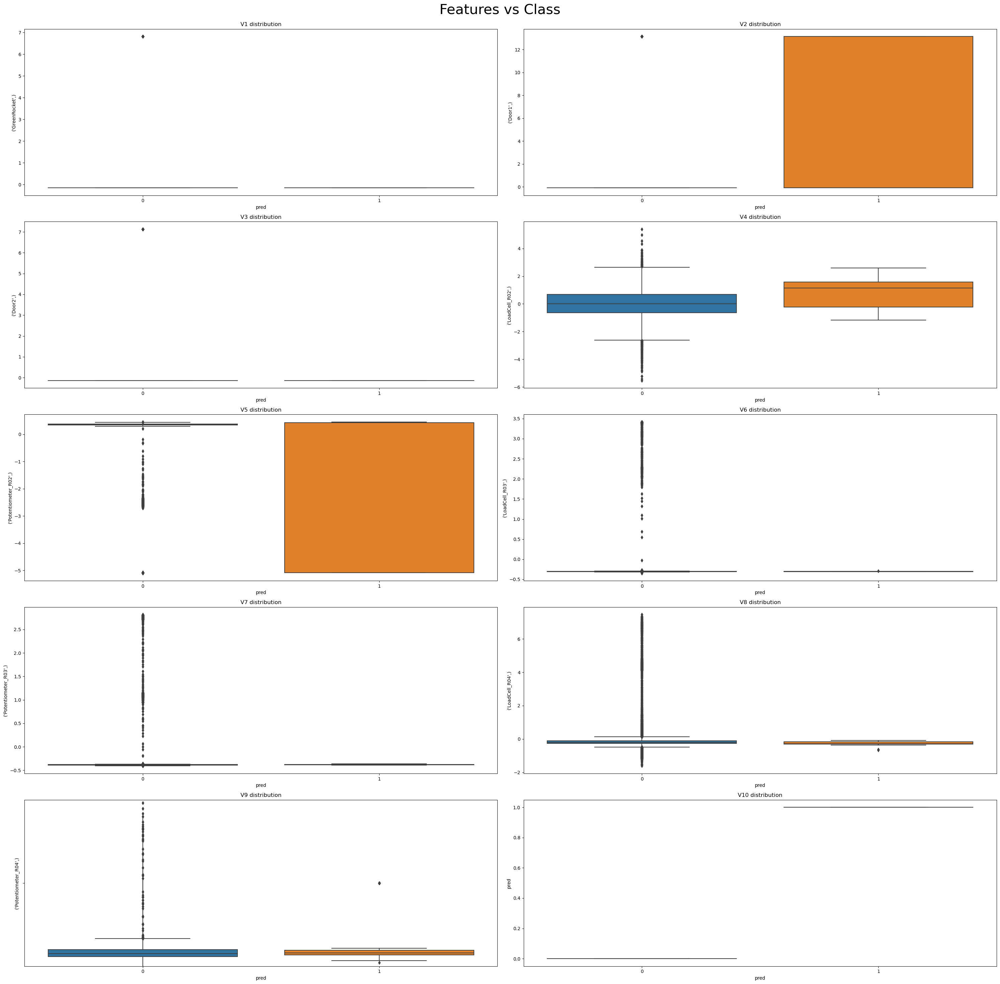

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axes = plt.subplots(nrows=5, ncols=2,figsize=(30,30))
fig.suptitle('Features vs Class\n', size = 30)
count=0
for i in range(5):
    for j in range(2):
        sns.boxplot(ax=axes[i, j], data=result, x='pred', y=result.columns[count])
        axes[i,j].set_title(f"V{count+1} distribution")
        count+=1       
plt.tight_layout()
sns.boxplot(ax=axes[4,0], data=result, x='pred')
plt.show()

In [50]:
import pandas as pd

d = {'GreenRocket': [1, 6, 6.81373434359678, 2], 
     'Potentiometer_R02': [0.338386287511026, 5, 0.353879359257215, 4],
     'pred': [0, 0, 1, 1]}

df = pd.DataFrame(data=d)
print(df)


   GreenRocket  Potentiometer_R02  pred
0     1.000000           0.338386     0
1     6.000000           5.000000     0
2     6.813734           0.353879     1
3     2.000000           4.000000     1


In [52]:
# Group by 'pred' and find the maximum and minimum values for each sensor variable
max_values = df.groupby('pred').max()
min_values = df.groupby('pred').min()

print("Maximum values grouped by response variable (pred):")
print(max_values)

print("\nMinimum values grouped by response variable (pred):")
print(min_values)

Maximum values grouped by response variable (pred):
      GreenRocket  Potentiometer_R02
pred                                
0        6.000000                5.0
1        6.813734                4.0

Minimum values grouped by response variable (pred):
      GreenRocket  Potentiometer_R02
pred                                
0             1.0           0.338386
1             2.0           0.353879


In [54]:
# Group by 'pred' and find the maximum and minimum values for each sensor variable
max_values = result.groupby('pred').max()
min_values = result.groupby('pred').min()

print("Maximum values grouped by response variable (pred):")
print(max_values)

print("\nMinimum values grouped by response variable (pred):")
print(min_values)

Maximum values grouped by response variable (pred):
      (GreenRocket,)   (Door1,)  (Door2,)  (LoadCell_R02,)  \
pred                                                         
0           6.813734  13.133128  7.131502         5.395020   
1          -0.146762  13.133128 -0.140223         2.587994   

      (Potentiometer_R02,)  (LoadCell_R03,)  (Potentiometer_R03,)  \
pred                                                                
0                 0.449051         3.417292              2.816574   
1                 0.454031        -0.289818             -0.360926   

      (LoadCell_R04,)  (Potentiometer_R04,)  
pred                                         
0            7.456040              0.544926  
1           -0.078824              0.478499  

Minimum values grouped by response variable (pred):
      (GreenRocket,)  (Door1,)  (Door2,)  (LoadCell_R02,)  \
pred                                                        
0          -0.146762 -0.076143 -0.140223        -5.534464   
1 

In [53]:
result

,"(GreenRocket,)","(Door1,)","(Door2,)","(LoadCell_R02,)","(Potentiometer_R02,)","(LoadCell_R03,)","(Potentiometer_R03,)","(LoadCell_R04,)","(Potentiometer_R04,)",pred
0,-0.146762,-0.076143,-0.140223,-1.353787,0.338386,-0.302917,-0.383225,-0.223474,0.421358,0
1,-0.146762,-0.076143,7.131502,1.632411,0.388185,-0.300130,-0.379456,4.388474,0.437429,0
2,-0.146762,-0.076143,-0.140223,1.811583,0.395932,-0.308770,-0.393904,-0.188558,-1.880013,0
3,-0.146762,-0.076143,-0.140223,0.736551,0.399252,3.373256,2.715128,0.121939,0.407430,0
4,-0.146762,-0.076143,-0.140223,0.676828,-2.568778,-0.302360,-0.379456,-0.083189,0.420644,0
...,...,...,...,...,...,...,...,...,...,...
42455,-0.146762,-0.076143,-0.140223,0.736551,0.379332,-0.312951,-0.385110,-0.290810,0.422072,0
42456,-0.146762,-0.076143,-0.140223,-0.875995,0.344473,-0.305426,-0.389507,-0.228462,-1.915012,0
42457,-0.146762,-0.076143,-0.140223,1.751859,0.411978,-0.301524,-0.381655,-0.229709,-1.936798,0
42458,-0.146762,-0.076143,-0.140223,-0.816271,0.349453,-0.305704,-0.384796,-0.239061,0.416715,0


In [29]:
model

XGBClassifier(base_score=0.5, booster='gbtree', callbacks=None,
              colsample_bylevel=1, colsample_bynode=1, colsample_bytree=1,
              early_stopping_rounds=None, enable_categorical=False,
              eval_metric=None, feature_types=None, gamma=0, gpu_id=-1,
              grow_policy='depthwise', importance_type=None,
              interaction_constraints='', learning_rate=0.300000012,
              max_bin=256, max_cat_threshold=64, max_cat_to_onehot=4,
              max_delta_step=0, max_depth=6, max_leaves=0, min_child_weight=1,
              missing=nan, monotone_constraints='()', n_estimators=1, n_jobs=0,
              num_parallel_tree=1, predictor='auto', random_state=0, ...)

In [108]:
# dump it to a text file
model.get_booster().dump_model('xgb_model.txt', with_stats=True)


In [109]:
# read the contents of the file
with open('xgb_model.txt', 'r') as f:
    txt_model = f.read()
print(txt_model)

booster[0]:
0:[Potentiometer_R02<0.568570375] yes=1,no=2,missing=1,gain=12.6530762,cover=747.5
	1:leaf=-0.59737134,cover=227.25
	2:[Potentiometer_R03<-0.844080925] yes=3,no=4,missing=3,gain=27.9685059,cover=520.25
		3:[Door1<-0.0974493623] yes=5,no=6,missing=5,gain=17.5476074,cover=349
			5:[LoadCell_R02<-1.019032] yes=9,no=10,missing=9,gain=6.81922913,cover=99.25
				9:[LoadCell_R03<0.480607092] yes=15,no=16,missing=15,gain=6.36508656,cover=16.25
					15:[Potentiometer_R04<-1.15132594] yes=25,no=26,missing=25,gain=1.87777901,cover=9
						25:leaf=-0,cover=1
						26:leaf=-0.433333337,cover=8
					16:[LoadCell_R04<0.404809773] yes=27,no=28,missing=27,gain=2.36363649,cover=7.25
						27:leaf=0.109090917,cover=4.5
						28:leaf=-0.200000018,cover=2.75
				10:[Potentiometer_R02<0.573073864] yes=17,no=18,missing=17,gain=4.84266663,cover=83
					17:leaf=0.0666666701,cover=1.25
					18:[LoadCell_R04<1.5011158] yes=29,no=30,missing=29,gain=2.5952301,cover=81.75
						29:leaf=-0.486238569,cove

In [112]:
import re
# trying to extract all patterns like "[f2<2.45]"
splits = re.findall('\[f([0-9]+)<([0-9]+.[0-9-e]+)\]', txt_model)
splits

[]

In [113]:
model.get_booster().get_dump()

['0:[Potentiometer_R02<0.568570375] yes=1,no=2,missing=1\n\t1:leaf=-0.59737134\n\t2:[Potentiometer_R03<-0.844080925] yes=3,no=4,missing=3\n\t\t3:[Door1<-0.0974493623] yes=5,no=6,missing=5\n\t\t\t5:[LoadCell_R02<-1.019032] yes=9,no=10,missing=9\n\t\t\t\t9:[LoadCell_R03<0.480607092] yes=15,no=16,missing=15\n\t\t\t\t\t15:[Potentiometer_R04<-1.15132594] yes=25,no=26,missing=25\n\t\t\t\t\t\t25:leaf=-0\n\t\t\t\t\t\t26:leaf=-0.433333337\n\t\t\t\t\t16:[LoadCell_R04<0.404809773] yes=27,no=28,missing=27\n\t\t\t\t\t\t27:leaf=0.109090917\n\t\t\t\t\t\t28:leaf=-0.200000018\n\t\t\t\t10:[Potentiometer_R02<0.573073864] yes=17,no=18,missing=17\n\t\t\t\t\t17:leaf=0.0666666701\n\t\t\t\t\t18:[LoadCell_R04<1.5011158] yes=29,no=30,missing=29\n\t\t\t\t\t\t29:leaf=-0.486238569\n\t\t\t\t\t\t30:leaf=-0\n\t\t\t6:leaf=-0.597607195\n\t\t4:[Potentiometer_R03<0.360537618] yes=7,no=8,missing=7\n\t\t\t7:[Potentiometer_R03<-0.840599716] yes=11,no=12,missing=11\n\t\t\t\t11:[Potentiometer_R02<0.626448035] yes=19,no=20,mis

In [129]:
G=model.get_booster().trees_to_dataframe()

In [131]:
G.to_csv('xgboost_tree.csv')

In [117]:
import networkx as nx

df = model._Booster.trees_to_dataframe()

G = nx.DiGraph()
G.add_nodes_from(df.ID.tolist())

yes_edges = df[['ID', 'Yes', 'Feature', 'Split']].dropna()
yes_edges['label'] = yes_edges.apply(lambda x: "({feature} > {value:.2f} ".format(feature=x['Feature'], value=x['Split']), axis=1)

no_edges = df[['ID', 'No', 'Feature', 'Split']].dropna()
no_edges['label'] = no_edges.apply(lambda x: "({feature} < {value:.2f})".format(feature=x['Feature'], value=x['Split']), axis=1)

for v in yes_edges.values:
    G.add_edge(v[0],v[1], feature=v[2], expr=v[4])
    
for v in no_edges.values:
    G.add_edge(v[0],v[1], feature=v[2], expr=v[4])

leaf_node_values = {i[0]:i[1] for i in df[df.Feature=='Leaf'][['ID','Gain']].values}    
    
roots = []
leaves = []
for node in G.nodes :
    if G.in_degree(node) == 0 : # it's a root
        roots.append(node)
    elif G.out_degree(node) == 0 : # it's a leaf
        leaves.append(node)
        
paths = []
for root in roots :
    for leaf in leaves :
        for path in nx.all_simple_paths(G, root, leaf) :
            paths.append(path)
    
pred_conditions = []
for path in paths:
    parts = []
    for i in range(len(path)-1):
        parts.append(G[path[i]][path[i+1]]['expr'])
    pred_conditions.append("if " + " and ".join(parts) + " then {value:.4f}".format(value=leaf_node_values.get(path[-1])))
    
pred_conditions

['if (Potentiometer_R02 > 0.57  then -0.5974',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 > -0.84  and (Door1 < -0.10) then -0.5976',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 < -0.84) and (Potentiometer_R03 < 0.36) and (Door1 < -0.10) then -0.5885',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 > -0.84  and (Door1 > -0.10  and (LoadCell_R02 < -1.02) and (Potentiometer_R02 > 0.57  then 0.0667',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 < -0.84) and (Potentiometer_R03 > 0.36  and (Potentiometer_R03 > -0.84  and (Potentiometer_R02 > 0.63  then 0.1636',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 < -0.84) and (Potentiometer_R03 > 0.36  and (Potentiometer_R03 > -0.84  and (Potentiometer_R02 < 0.63) then -0.3000',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 < -0.84) and (Potentiometer_R03 > 0.36  and (Potentiometer_R03 < -0.84) and (LoadCell_R02 > 0.10  then -0.0545',
 'if (Potentiometer_R02 < 0.57) and (Potentiometer_R03 

<AxesSubplot:>

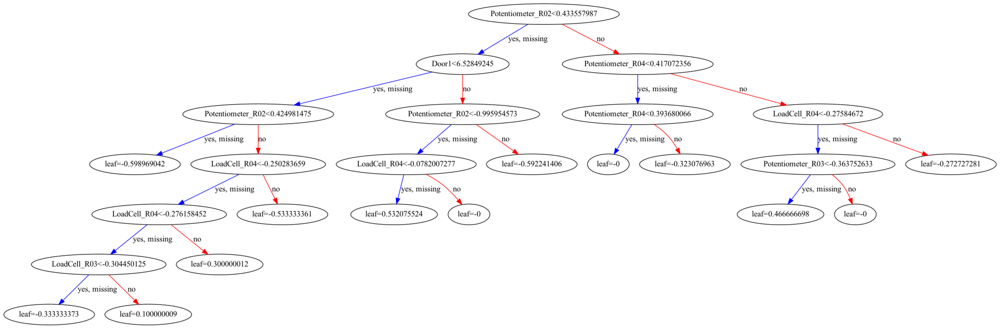

In [30]:
%matplotlib inline
from xgboost import plot_tree
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 80,50
plot_tree(model)

<AxesSubplot:>

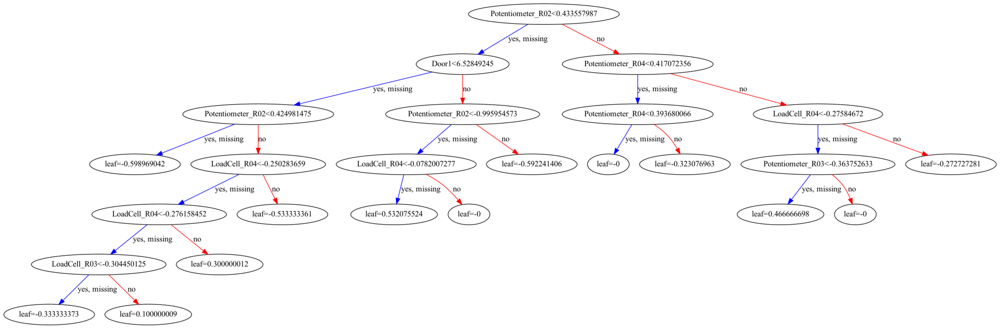

In [31]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=0)

In [ ]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=1)

<AxesSubplot:>

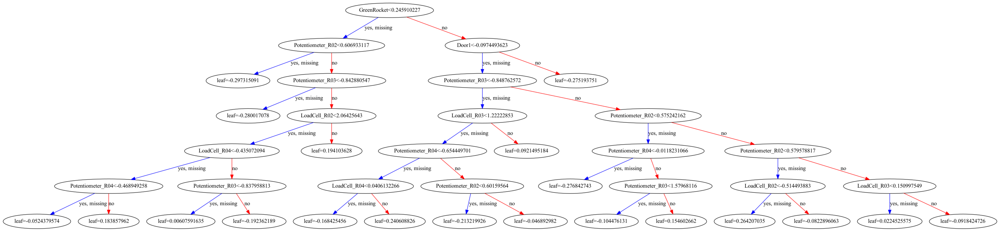

In [122]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=10)

<AxesSubplot:>

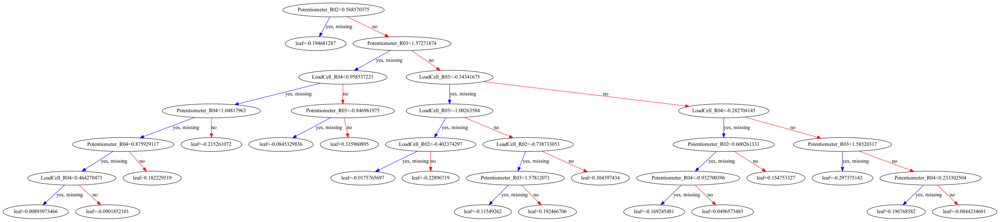

In [127]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=20)

<AxesSubplot:>

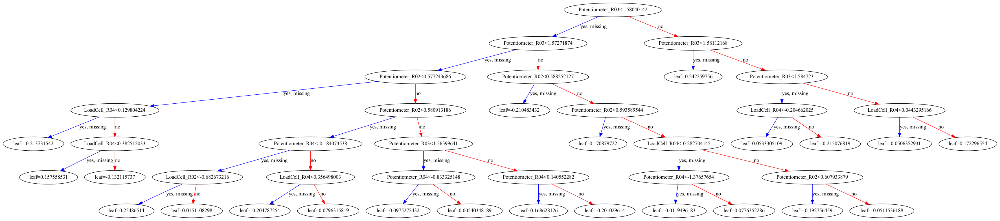

In [128]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=30)

<AxesSubplot:>

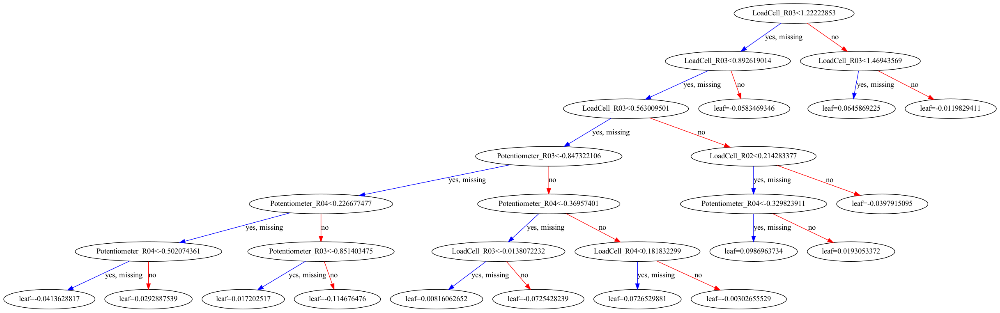

In [126]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=97)

<AxesSubplot:>

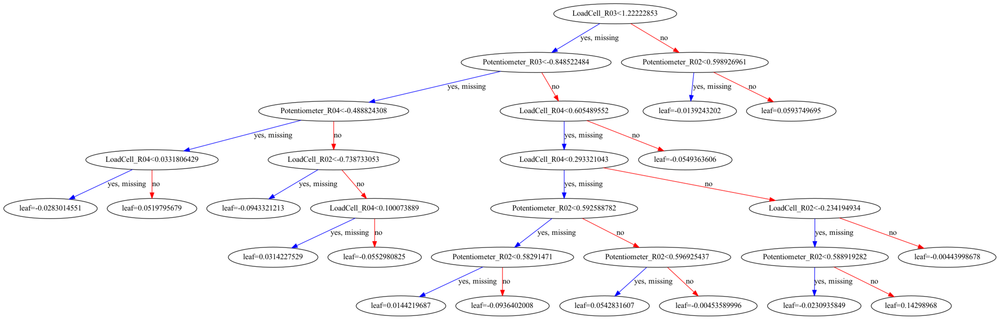

In [125]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=98)

<AxesSubplot:>

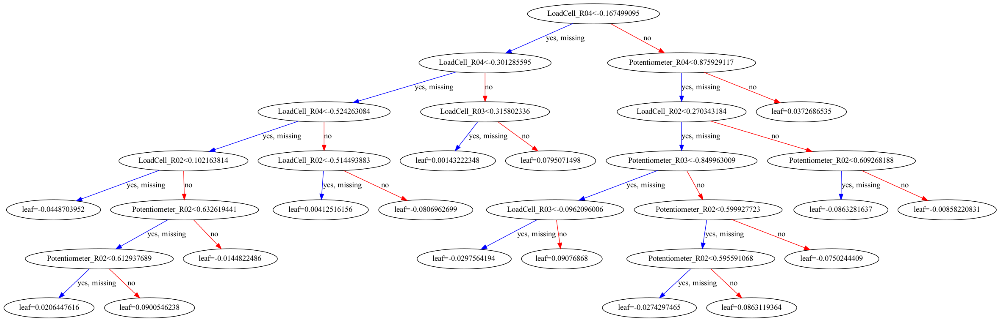

In [124]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=99)

# Weighted XGBoost for Class Imbalance


In [22]:
# define model
#scale_pos_weight=total_negative_examples / total_positive_examples
#total number of examples in the majority class / total number of examples in the minority class.
#21604/375=57.6
model = XGBClassifier(scale_pos_weight=58)

# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.5f' % mean(scores))

Mean ROC AUC: 0.89294


In [23]:
clf_1 = model.fit(X_train, y_train)
pred_y_1 = clf_1.predict(X_test)

print(accuracy_score(pred_y_1, y_test))

0.929144385026738


In [24]:
target_names = ['class 0', 'class 1']
print(classification_report(y_test, pred_y_1, target_names=target_names))

confusion_matrix(y_test, pred_y_1)

              precision    recall  f1-score   support

     class 0       0.96      0.96      0.96       705
     class 1       0.39      0.42      0.40        43

    accuracy                           0.93       748
   macro avg       0.68      0.69      0.68       748
weighted avg       0.93      0.93      0.93       748



array([[677,  28],
       [ 25,  18]])

# Tune with GridSearch CV

In [159]:
# define grid
weights = [1, 10, 25, 50, 75, 99, 100, 1000]
param_grid = dict(scale_pos_weight=weights)

In [22]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
# define evaluation procedure
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# define grid search
grid = GridSearchCV(estimator=model, param_grid=param_grid, n_jobs=-1, cv=cv, scoring='roc_auc')

In [33]:
# execute the grid search
grid_result = grid.fit(X, y)
# report the best configuration
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
# report all configurations
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

/Users/chathurangishyalika/opt/anaconda3/envs/tf/lib/python3.7/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)


[13:03:30] WARNING: /var/folders/sy/f16zz6x50xz3113nwtb9bvq00000gp/T/abs_44tbtwf8c1/croots/recipe/xgboost-split_1659548960882/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Best: 0.931436 using {'scale_pos_weight': 1}
0.931436 (0.040774) with: {'scale_pos_weight': 1}
0.927670 (0.048305) with: {'scale_pos_weight': 10}
0.929479 (0.045071) with: {'scale_pos_weight': 25}
0.922069 (0.046362) with: {'scale_pos_weight': 50}
0.923126 (0.051366) with: {'scale_pos_weight': 75}
0.922714 (0.053929) with: {'scale_pos_weight': 99}
0.922413 (0.053952) with: {'scale_pos_weight': 100}
0.905774 (0.058887) with: {'scale_pos_weight': 1000}


In [25]:
# define model
model = XGBClassifier(scale_pos_weight=75)

# define evaluation procedure
#cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
# evaluate model
#scores = cross_val_score(model, X, y, scoring='roc_auc', cv=cv, n_jobs=-1)
# summarize performance
print('Mean ROC AUC: %.5f' % mean(scores))

Mean ROC AUC: 0.89294


In [26]:
clf_2 = model.fit(X_train, y_train)
pred_y_2 = clf_2.predict(X_test)

print(accuracy_score(pred_y_2, y_test))



0.93048128342246


In [27]:
target_names = ['class 0', 'class 1']
print(classification_report(y_test, pred_y_2, target_names=target_names))

confusion_matrix(y_test, pred_y_2)

              precision    recall  f1-score   support

     class 0       0.96      0.96      0.96       705
     class 1       0.39      0.37      0.38        43

    accuracy                           0.93       748
   macro avg       0.68      0.67      0.67       748
weighted avg       0.93      0.93      0.93       748



array([[680,  25],
       [ 27,  16]])

<AxesSubplot:>

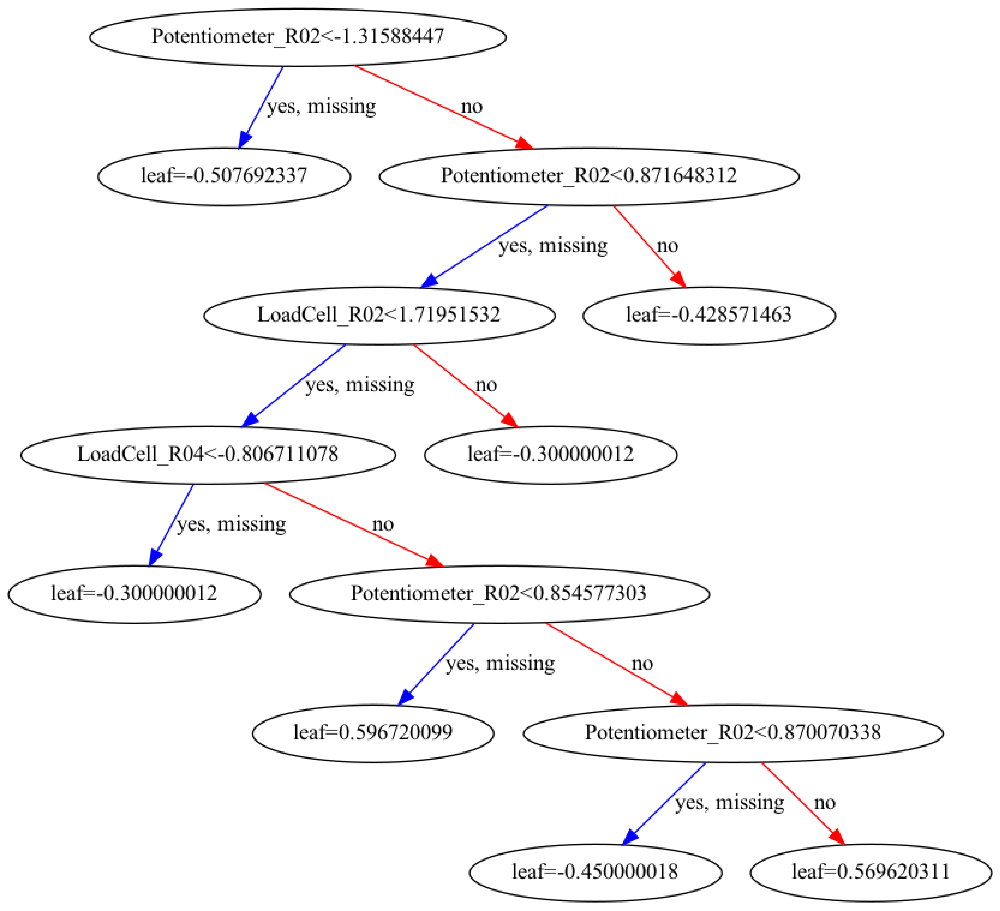

In [264]:
%matplotlib inline
from xgboost import plot_tree
from matplotlib.pylab import rcParams

##set up the parameters
rcParams['figure.figsize'] = 80,50

plot_tree(model)
#yes, missing here means this tree has handled missing values

In [55]:
import numpy as np
import xgboost as xgb
from sklearn import datasets
from scipy.special import expit as sigmoid, logit as inverse_sigmoid



# Fit a model
model = xgb.XGBClassifier(
    n_estimators=100,
    max_depth=10,
    use_label_encoder=False,
    objective='binary:logistic'
)
model.fit(X, y)
booster_ = model.get_booster()

# Extract indivudual predictions
individual_preds = []
for tree_ in booster_:
    individual_preds.append(
        tree_.predict(xgb.DMatrix(X))
    )
individual_preds
individual_preds = np.vstack(individual_preds)

# Aggregated individual predictions to final predictions
indivudual_logits = inverse_sigmoid(individual_preds)
final_logits = indivudual_logits.sum(axis=0)
final_preds = sigmoid(final_logits)
final_preds

# Verify correctness
xgb_preds = booster_.predict(xgb.DMatrix(X))
#np.testing.assert_almost_equal(final_preds, xgb_preds)

In [169]:
type(X)

numpy.ndarray

In [170]:
type(y)

numpy.ndarray

In [172]:
X

array([[    0,     1,     0, ...,  2388,  2522, 12053],
       [    0,     1,     0, ...,  2388,  2651, 12150],
       [    0,     1,     0, ...,  2392,  2460, 12003],
       ...,
       [    0,     0,     0, ...,  2403,  3218, 11917],
       [    0,     0,     0, ...,  2385,  2176, 11904],
       [    0,     0,     0, ...,  2396,  3437, 11906]])

In [173]:
y

array([0., 0., 0., ..., 0., 0., 0.])

In [45]:
xgb_preds

array([0.02241457, 0.02241457, 0.02241457, ..., 0.9656135 , 0.9606834 ,
       0.9656135 ], dtype=float32)

In [44]:
individual_preds

array([[0.35457015, 0.35457015, 0.35457015, ..., 0.63308036, 0.63308036,
        0.63308036],
       [0.3860945 , 0.3860945 , 0.3860945 , ..., 0.60416716, 0.60416716,
        0.60416716],
       [0.40072665, 0.40072665, 0.40072665, ..., 0.5935726 , 0.5935726 ,
        0.5935726 ],
       ...,
       [0.42146406, 0.42146406, 0.42146406, ..., 0.56412035, 0.56412035,
        0.56412035],
       [0.42269   , 0.42269   , 0.42269   , ..., 0.5575611 , 0.52302635,
        0.5575611 ],
       [0.42352572, 0.42352572, 0.42352572, ..., 0.5680123 , 0.5680123 ,
        0.5680123 ]], dtype=float32)

In [46]:
from numpy import savetxt

savetxt('xgbdata_mcnair3.csv', xgb_preds, delimiter=',')

In [48]:

savetxt('xgbdata_mcnair3_final_preds.csv', final_preds, delimiter=',')

In [51]:
indivudual_logits
savetxt('xgbdata_mcnair3_final_indivudual_logits.csv', indivudual_logits, delimiter=',')

In [50]:
final_logits

array([-3.7753747, -3.7753747, -3.7753747, ...,  3.335098 ,  3.1959991,
        3.335098 ], dtype=float32)

In [52]:
indivudual_logits

array([[-0.59901035, -0.59901035, -0.59901035, ...,  0.54545456,
         0.54545456,  0.54545456],
       [-0.46375877, -0.46375877, -0.46375877, ...,  0.4228589 ,
         0.4228589 ,  0.4228589 ],
       [-0.4024383 , -0.4024383 , -0.4024383 , ...,  0.3787543 ,
         0.3787543 ,  0.3787543 ],
       ...,
       [-0.31676617, -0.31676617, -0.31676617, ...,  0.25790146,
         0.25790146,  0.25790146],
       [-0.31174028, -0.31174028, -0.31174028, ...,  0.2312697 ,
         0.09217062,  0.2312697 ],
       [-0.30831653, -0.30831653, -0.30831653, ...,  0.27374595,
         0.27374595,  0.27374595]], dtype=float32)

In [56]:
individual_preds

array([[0.35457015, 0.35457015, 0.35457015, ..., 0.63308036, 0.63308036,
        0.63308036],
       [0.3860945 , 0.3860945 , 0.3860945 , ..., 0.60416716, 0.60416716,
        0.60416716],
       [0.40072665, 0.40072665, 0.40072665, ..., 0.5935726 , 0.5935726 ,
        0.5935726 ],
       ...,
       [0.48448944, 0.48448944, 0.50645   , ..., 0.5084631 , 0.524707  ,
        0.5084631 ],
       [0.47946185, 0.5106923 , 0.5046929 , ..., 0.47946185, 0.5271554 ,
        0.5106923 ],
       [0.50694275, 0.50694275, 0.4907371 , ..., 0.4907371 , 0.4997697 ,
        0.50939643]], dtype=float32)

In [57]:
savetxt('xgbdata_mcnair3_final_individual_predss.csv', individual_preds, delimiter=',')

<AxesSubplot:>

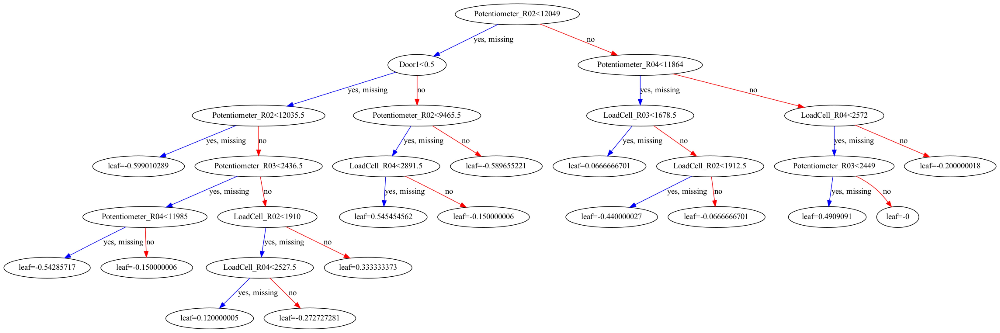

In [58]:
%matplotlib inline
from xgboost import plot_tree
from matplotlib.pylab import rcParams

##set up the parameters
rcParams['figure.figsize'] = 80,50

plot_tree(model)
#yes, missing here means this tree has handled missing values

<AxesSubplot:>

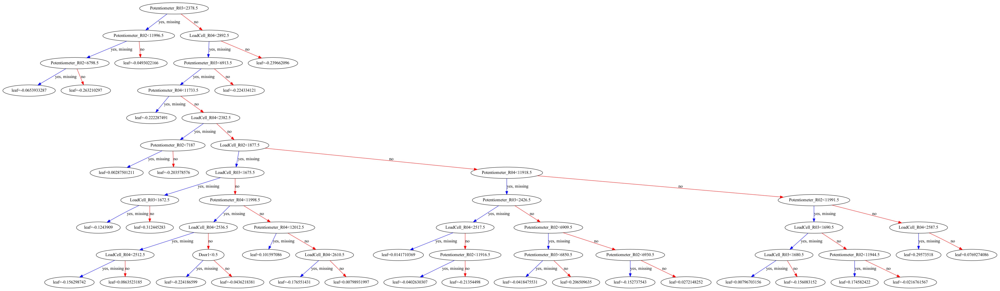

In [59]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=29)

<AxesSubplot:>

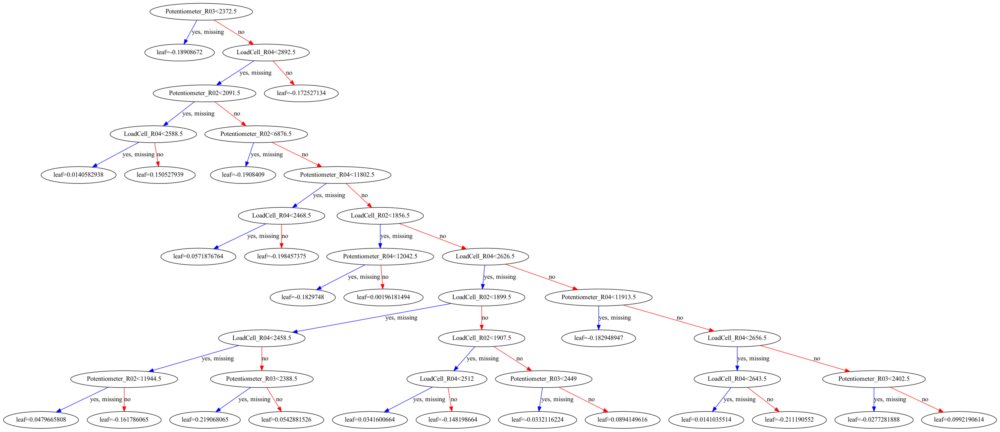

In [60]:
rcParams['figure.figsize'] = 80,50
plot_tree(model, num_trees=35)